In [13]:
import os 
DIR_PATH = os.path.join(os.getcwd() , "yolov7_dectection_aquarium")

In [2]:
import os 
os.makedirs(DIR_PATH , exist_ok=True)
os.chdir(DIR_PATH)

assert os.getcwd() == DIR_PATH

In [3]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5 
# install dependencies as necessary
!git reset --hard fbe67e465375231474a2ad80a4389efc77ecff99

!pip install -qr yolov5/requirements.txt 

Cloning into 'yolov5'...
remote: Enumerating objects: 14397, done.
remote: Counting objects: 100% (55/55), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 14397 (delta 28), reused 41 (delta 21), pack-reused 14342
Receiving objects: 100% (14397/14397), 13.47 MiB | 24.00 MiB/s, done.
Resolving deltas: 100% (9933/9933), done.
fatal: not a git repository (or any parent up to mount point /)
Stopping at filesystem boundary (GIT_DISCOVERY_ACROSS_FILESYSTEM not set).


In [3]:
%cd yolov5

/notebooks/yolov7_dectection_aquarium/yolov5


In [5]:
!pip install roboflow -q

from roboflow import Roboflow
rf = Roboflow(api_key="neIVZe1oNb0LYT5wm4nT")
project = rf.workspace("brad-dwyer").project("aquarium-combined")
dataset = project.version(3).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [5]:
import torch
import yaml
from IPython.core.magic import register_line_cell_magic
from IPython.display import Image, clear_output  # to display images
from utils.downloads import attempt_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.12.0+cu116 _CudaDeviceProperties(name='NVIDIA RTX A4000', major=8, minor=6, total_memory=16117MB, multi_processor_count=48)


In [8]:
os.getcwd() , os.listdir()

('/notebooks/yolov7_dectection_aquarium/yolov5',
 ['.dockerignore',
  'requirements.txt',
  'val.py',
  'classify',
  'README.md',
  '.pre-commit-config.yaml',
  'train.py',
  'Aquarium-Combined-3',
  'hubconf.py',
  'segment',
  'benchmarks.py',
  '.github',
  'LICENSE',
  'export.py',
  'CONTRIBUTING.md',
  '.gitattributes',
  '.git',
  'tutorial.ipynb',
  'detect.py',
  'models',
  'setup.cfg',
  'data',
  '.gitignore',
  'utils'])

In [9]:
%cat ./Aquarium-Combined-3/data.yaml

names:
- fish
- jellyfish
- penguin
- puffin
- shark
- starfish
- stingray
nc: 7
train: Aquarium-Combined-3/train/images
val: Aquarium-Combined-3/valid/images


In [10]:
# define number of classes based on YAML
with open( "./Aquarium-Combined-3/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])
    display(num_classes)

'7'

In [11]:
#this is the model configuration we will use for our tutorial 
%cat ./models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [12]:
@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [13]:
%%writetemplate ./models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [14]:
%cat ./models/custom_yolov5s.yaml


# parameters
nc: 7  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, Fa

In [15]:
%%time

!python train.py --img 416 --batch 16 --epochs 2000 --data Aquarium-Combined-3/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

train: weights=, cfg=./models/custom_yolov5s.yaml, data=Aquarium-Combined-3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=2000, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-224-g82a5585 Python-3.9.13 torch-1.12.0+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

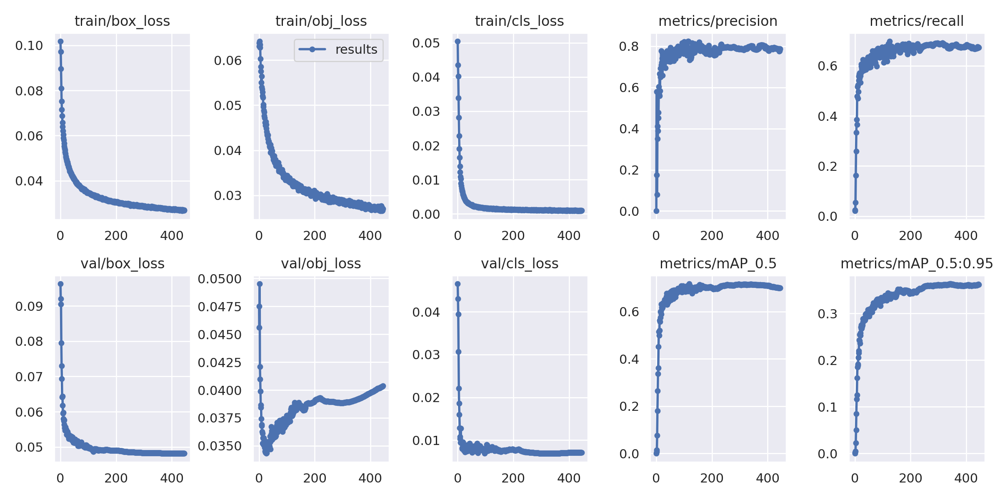

In [6]:
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='./runs/train/yolov5s_results/results.png', width=1000) 

GROUND TRUTH TRAINING DATA:


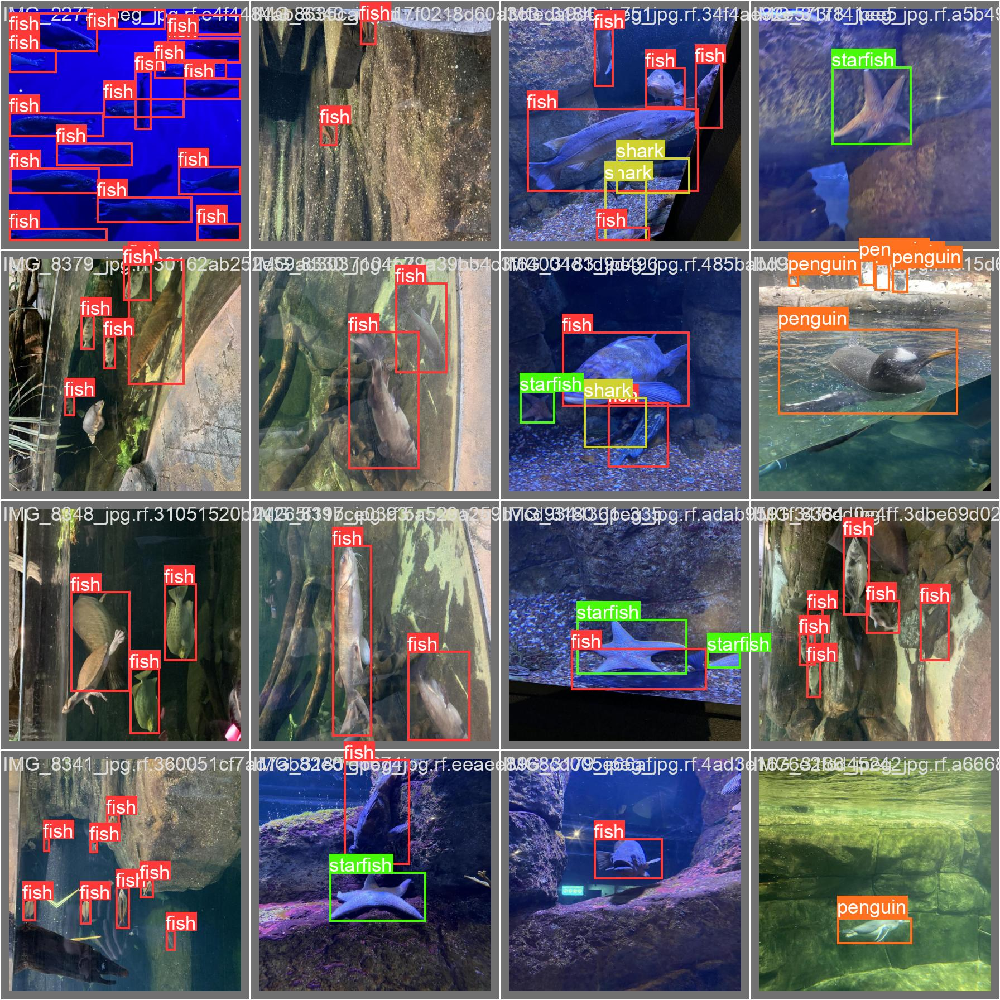

In [7]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='./runs/train/yolov5s_results/val_batch0_labels.jpg', width=900)

In [8]:
%ls runs/

train/


In [9]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [11]:

# use the best weights!
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ./Aquarium-Combined-3/test/images

detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=./Aquarium-Combined-3/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-224-g82a5585 Python-3.9.13 torch-1.12.0+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
image 1/63 /notebooks/yolov7_dectection_aquarium/yolov5/Aquarium-Combined-3/test/images/IMG_2289_jpeg_jpg.rf.ed11415683226df2655cc1522a0ae231.jpg: 416x416 1 puffin, 8.5ms
image 2/63 /notebooks/yolov7_dectection_aquarium/yolov5/Aquarium-Combined-3/test/images/IMG_2301_jpeg_jpg.rf.2650b6b2f9acb407987b5990

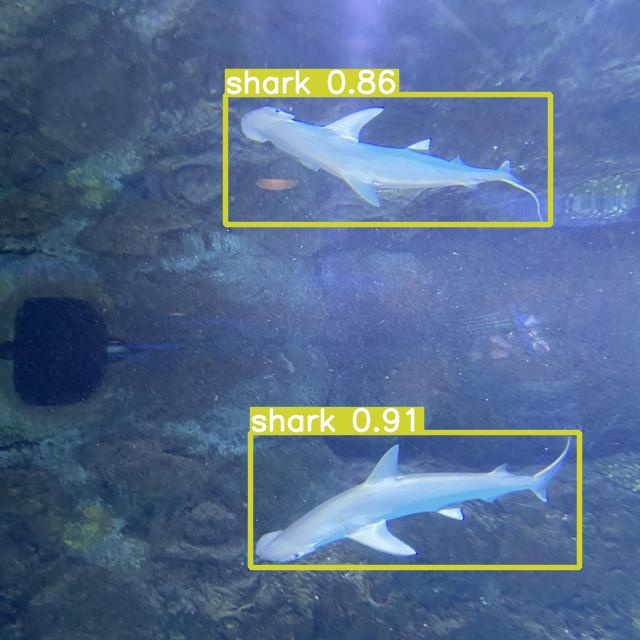

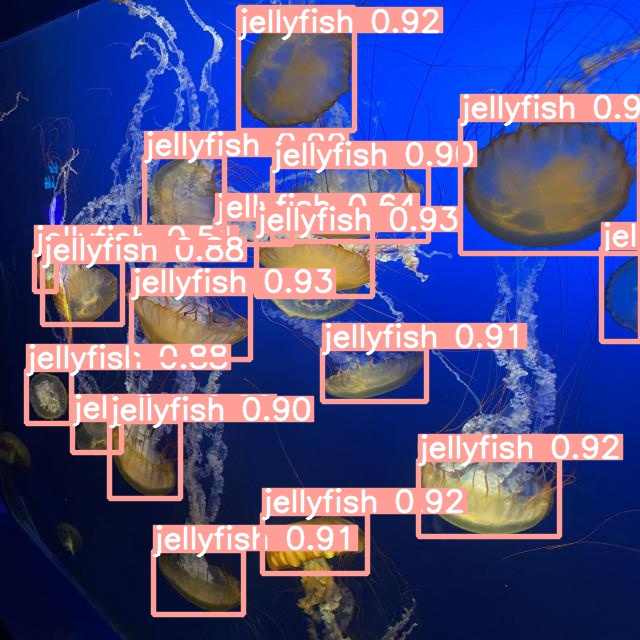

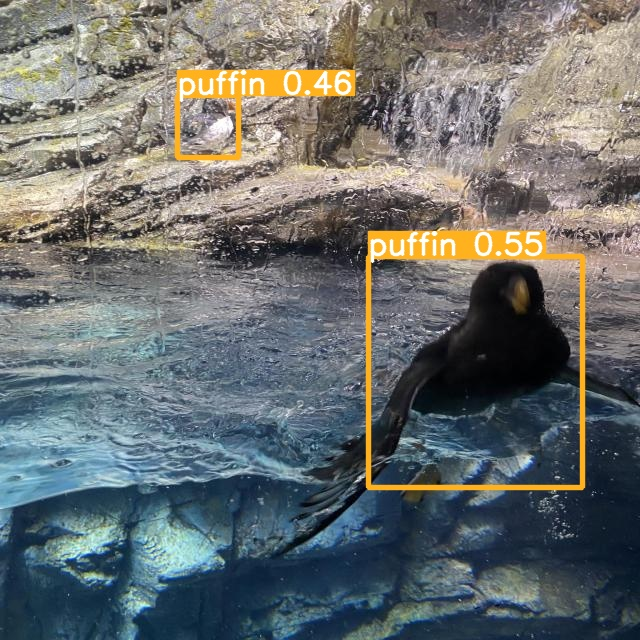

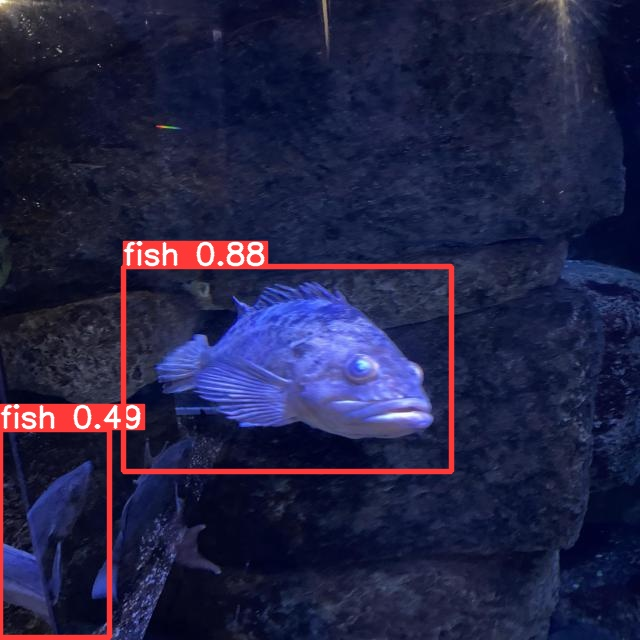

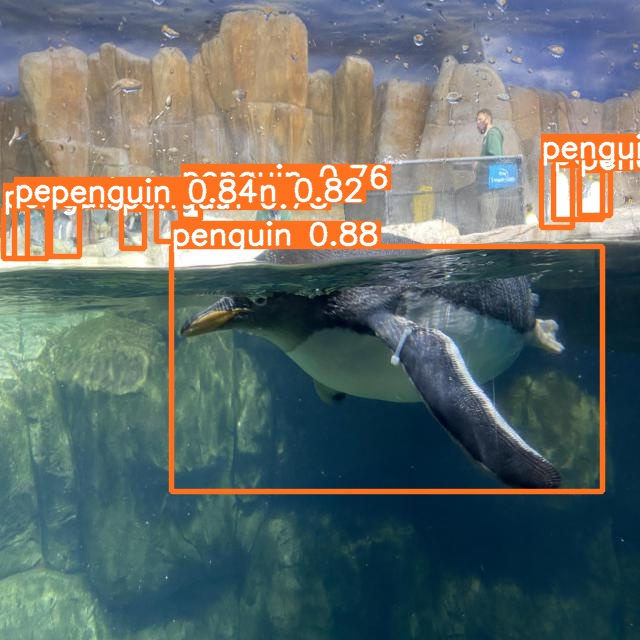

...

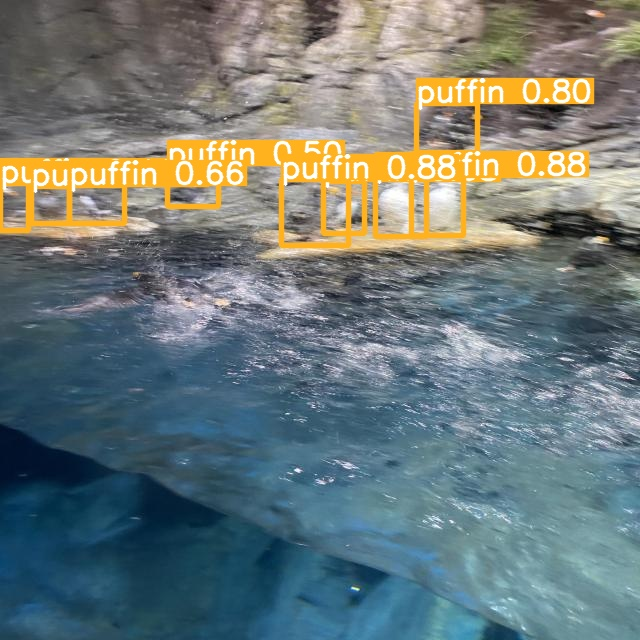

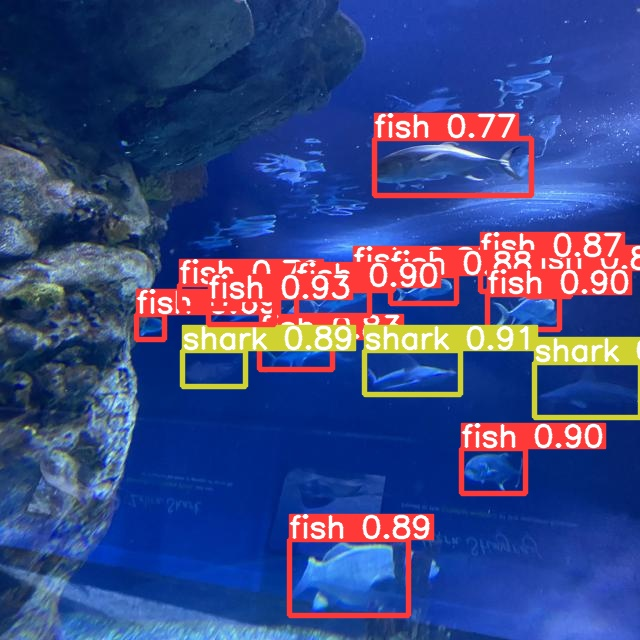

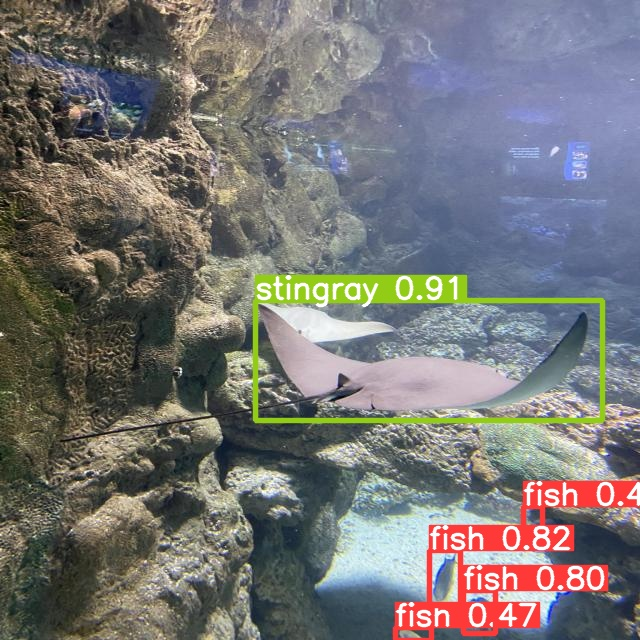

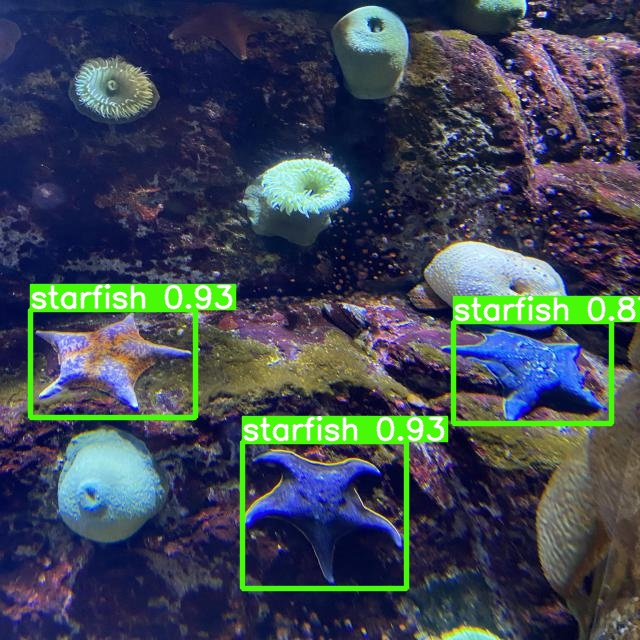

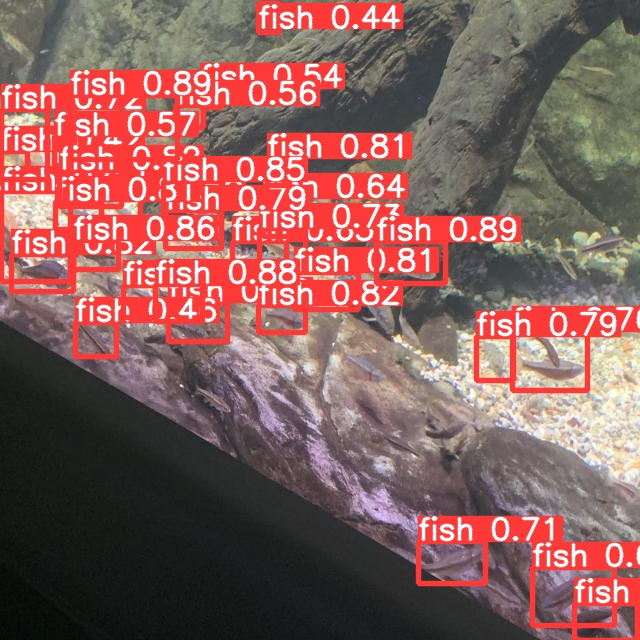

In [12]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('./runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")